# **SET-UP**

In this section, the relavant libraries are imported, and the training, validation and test datasets are prepared.

If the notebook is running on Google Colab, the data can be downloaded to the environment by running the corresponding cell.

In [ ]:
# imports

import os
import sys
from pathlib import Path

import torch
import torch.nn as nn
import torch.nn.functional
from torchvision import transforms

import matplotlib.pyplot as plt
import numpy as np

import cv2
from PIL import Image

### Download Data into Google Colab Environment

This cell should only be executed if the notebook is running on Google Colab.

If the notebook is running locally with the data already situated in the correct directory, this cell block should **not** be run.

In [ ]:
# download if zip files not already downloaded
if not os.path.exists('data.zip'):
    !gdown '1KCEr8wD4vGuYhop8ShshLFPnx-3wzeSW'
else:
    print('data.zip already exists')

# unzip if folders don't already exist
if not os.path.exists('data'):
    !unzip -qq data.zip
    !rm data.zip
else:
    print('data folder already exists')

Downloading...
From (original): https://drive.google.com/uc?id=1KCEr8wD4vGuYhop8ShshLFPnx-3wzeSW
From (redirected): https://drive.google.com/uc?id=1KCEr8wD4vGuYhop8ShshLFPnx-3wzeSW&confirm=t&uuid=7678870c-2bd2-4fbb-af75-a01da0c89641
To: /content/data.zip
100% 289M/289M [00:03<00:00, 92.9MB/s]


In [ ]:
# download if zip files not already downloaded
if not os.path.exists('utils.zip'):
    !gdown '1gpmibySGF2wxCMRcE_0V9duUf27U5270'
else:
    print('utils.zip already exists')

# unzip if folders don't already exist
if not os.path.exists('utils'):
    !unzip -qq utils.zip
    !rm utils.zip
else:
    print('utils folder already exists')

Downloading...
From: https://drive.google.com/uc?id=1gpmibySGF2wxCMRcE_0V9duUf27U5270
To: /content/utils.zip
100% 2.85k/2.85k [00:00<00:00, 15.0MB/s]


## Constructing Datasets

Informally experimenting with various batch sizes,demonstrated that a batch size of four yielded the best results.

In [ ]:
# batch size
B = 4

The appropriate transformations can be applied for training, validation and test data.

In [ ]:
from torch.utils.data import random_split, DataLoader
from utils.seq_dataset import SeqDataset
from utils.data_management import get_transform, initialize_loader

# set up dataset
dataset = SeqDataset(root_dir='data', transform=None)

# picking out the sizes
train_size = int(0.6 * len(dataset))              # 60% for training
val_size = int(0.1 * len(dataset))                # 10% for validation
test_size = len(dataset) - train_size - val_size  # 30 for testing

# split the dataset into train, validation, and test sets
train_dataset, val_dataset, test_dataset = random_split(dataset, [train_size, val_size, test_size])

# dataloaders
train_loader = initialize_loader(train_dataset, get_transform("train"), B, True)
val_loader = initialize_loader(val_dataset, get_transform("validation"), B, False)
test_loader = initialize_loader(test_dataset, get_transform("test"), B, False)

### Visualize Data

This cell can be optionally executed to visualize the structure of the dataset.

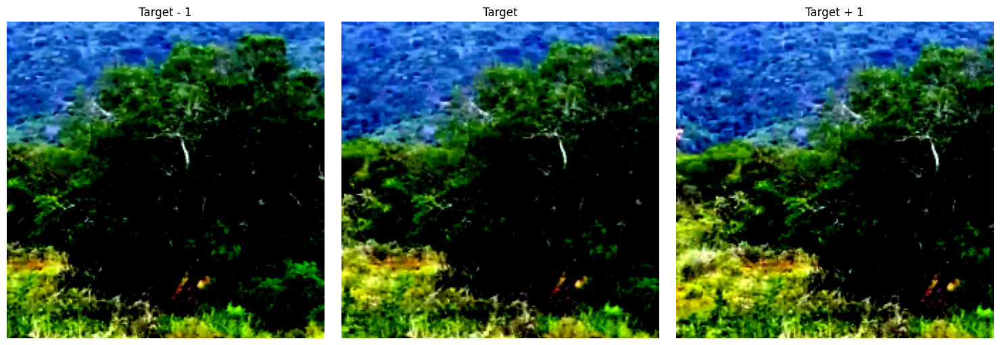

In [ ]:
tgt, [s1, s2] = train_dataset[10]
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.title("Target - 1")
plt.imshow(s1.permute(1, 2, 0).numpy().clip(0, 1))
plt.axis('off')

plt.subplot(1, 3, 2)
plt.title("Target")
plt.imshow(tgt.permute(1, 2, 0).numpy().clip(0, 1))
plt.axis('off')

plt.subplot(1, 3, 3)
plt.title("Target + 1")
plt.imshow(s2.permute(1, 2, 0).numpy().clip(0, 1))
plt.axis('off')

plt.tight_layout()
plt.show()

# **ARCHITECTURE**

##### Pose Network

In [ ]:
# pose estimation network
class PoseNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(6, 16, 7, stride=2, padding=3),
            nn.ReLU(),
            nn.Conv2d(16, 32, 5, stride=2, padding=2),
            nn.ReLU(),
            nn.Conv2d(32, 64, 3, stride=2, padding=1),
            nn.ReLU(),
            nn.AdaptiveAvgPool2d(1),
            nn.Flatten(),
            nn.Linear(64, 6)
        )

    # forward pass
    def forward(self, src, tgt):
        x = torch.cat([src, tgt], dim=1)
        return self.net(x)

## DEPTH ESTIMATION

### Version A: Simple Upsample

In [ ]:
import torch.nn as nn
from torchvision.models import resnet18, ResNet18_Weights

# depth estimation network
class DepthNet_A(nn.Module):
    def __init__(self):
        super().__init__()
        # encoder is constructed with a resnet18 backbone
        self.encoder = nn.Sequential(*list(resnet18(weights=ResNet18_Weights.DEFAULT).children())[:-2])

        # decoder reconstructs image with upsampling
        self.decoder = nn.Sequential(
            nn.Conv2d(512, 256, 3, padding=1),
            nn.ReLU(),
            nn.Upsample(scale_factor=2),
            nn.Conv2d(256, 128, 3, padding=1),
            nn.ReLU(),
            nn.Upsample(scale_factor=2),
            nn.Conv2d(128, 64, 3, padding=1),
            nn.ReLU(),
            nn.Upsample(scale_factor=2),
            nn.Conv2d(64, 32, 3, padding=1),
            nn.ReLU(),
            nn.Upsample(scale_factor=2),
            nn.Conv2d(32, 16, 3, padding=1),
            nn.ReLU(),
            nn.Upsample(scale_factor=2),
            nn.Conv2d(16, 1, 1),
            nn.Sigmoid()
        )

    # forward pass: encoder -> decoder
    def forward(self, x):
        return self.decoder(self.encoder(x))

### Version B: Upsample + skip connections (unet)

In [ ]:
import torch
import torch.nn as nn
from torchvision.models import resnet18, ResNet18_Weights

# depth encoder
class Encoder(nn.Module):
    def __init__(self):
        super().__init__()
        # resnet as a backbone
        res_encoder = nn.Sequential(*list(resnet18(weights=ResNet18_Weights.DEFAULT).children())[:-2])

        # layers of resnet to extract skip connections
        self.b0 = nn.Sequential(
            res_encoder[0],
            res_encoder[1],
            res_encoder[2])
        self.mp = res_encoder[3]
        self.b1 = res_encoder[4]
        self.b2 = res_encoder[5]
        self.b3 = res_encoder[6]
        self.b4 = res_encoder[7]

    def forward(self, x):
        x0 = self.b0(x)
        x1 = self.mp(x0)
        x1 = self.b1(x1)
        x2 = self.b2(x1)
        x3 = self.b3(x2)
        x4 = self.b4(x3)
        return x0, x1, x2, x3, x4


# depth encoder layer
class Decoder(nn.Module):
    def __init__(self, in_channels, skip_channels, out_channels):
        super().__init__()
        # learnable upsampling
        self.up = nn.ConvTranspose2d(in_channels, out_channels, kernel_size=2, stride=2)

        # conv block after concatenation with skip
        self.conv = nn.Sequential(
            nn.Sequential(
                nn.Conv2d(out_channels + skip_channels, out_channels, kernel_size=3, padding=1),
                nn.BatchNorm2d(out_channels),
                nn.ReLU(inplace=True)),
            nn.Sequential(
                nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
                nn.BatchNorm2d(out_channels)),
                nn.ReLU(inplace=True))

    def forward(self, x, skip):
        x = self.up(x)
        x = torch.cat([x, skip], dim=1)
        x = self.conv(x)
        return x

# depth estimation network
class DepthNet_B(nn.Module):
    def __init__(self):
        super().__init__()
        # encoder is constructed with a resnet18 backbone
        self.encoder = Encoder()

        # decoder reconstructs image with upsampling
        self.dec3 = Decoder(512, 256, 256)
        self.dec2 = Decoder(256, 128, 128)
        self.dec1 = Decoder(128, 64, 64)
        self.dec0 = Decoder(64, 64, 64)

        self.final_conv = nn.Conv2d(64, 1, kernel_size=1)

    # forward pass: encoder -> decoder
    def forward(self, x):
        # pass thru decoder layers
        x0, x1, x2, x3, x4 = self.encoder(x)
        d3 = self.dec3(x4, x3)
        d2 = self.dec2(d3, x2)
        d1 = self.dec1(d2, x1)
        d0 = self.dec0(d1, x0)

        # final upsample to input size
        out = nn.functional.interpolate(d0, size=x.shape[2:], mode="bilinear", align_corners=False)
        out = self.final_conv(out)
        return out

# **TRAINING**

##### set-up

In [ ]:
from utils.visual_helpers import plot_train_loss

# load device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# set up standard intrinsics
intrinsics = torch.eye(3).unsqueeze(0).repeat(B, 1, 1).to(device)

In [ ]:
curr_epoch = 0
# training the model
def train(fwd_pass, optimizer, tracked_loss, epochs=60):
    # reset the tracked losses
    tracked_loss = []
    curr_epoch = 0

    # training loop
    for epoch in range(epochs):
        print(f"\nEPOCH {epoch + 1} -----------------------------")

        # loss tracking variables
        total_loss = 0.0
        num_batches = 0

        # iterate over batches
        for input_data in train_loader:
            # forward pass
            loss = fwd_pass(input_data)

            # backpropagation
            loss.backward()
            optimizer.step()
            optimizer.zero_grad()

            # track loss
            total_loss += loss.item()
            num_batches += 1

        # track loss over epochs
        avg_loss = total_loss / num_batches
        tracked_loss.append(avg_loss)
        curr_epoch+=1

        # print loss
        print(f"[average loss: {avg_loss:.4f}]")

##### helpers

In [ ]:
# converts 6D pose vector into a transformation matrix (rotation + translation)
def pose_vec2mat(vec):
    # extract translation vector
    t = vec[:, :3].unsqueeze(-1)

    # extract rotation vector
    angle = vec[:, 3:]

    # normalize to compute values
    angle_norm = torch.norm(angle, dim=1, keepdim=True)
    axis = angle / (angle_norm + 1e-8)  # rotation axis
    angle = angle_norm.unsqueeze(-1)    # angle

    # compute cross product matrices for each batch
    cross = torch.zeros(vec.shape[0], 3, 3).to(vec.device)
    cross[:, 0, 1] = -axis[:, 2]
    cross[:, 0, 2] = axis[:, 1]
    cross[:, 1, 0] = axis[:, 2]
    cross[:, 1, 2] = -axis[:, 0]
    cross[:, 2, 0] = -axis[:, 1]
    cross[:, 2, 1] = axis[:, 0]

    # rotation matrix calculation
    R = torch.eye(3, device=vec.device).unsqueeze(0) + \
        torch.sin(angle) * cross + \
        (1 - torch.cos(angle)) * torch.bmm(cross, cross)

    # arbitrary bottom row for matrix
    btm = torch.tensor([0, 0, 0, 1], device=vec.device).view(1, 1, 4).repeat(vec.shape[0], 1, 1)

    # construct final 4x4 transformation matrix
    T = torch.cat([R, t], dim=-1)                    # concatenate rotation + translation -> 3x4
    transformation_mtx = torch.cat([T, btm], dim=1)  # concatenate bottom row -> 4x4

    return transformation_mtx

In [ ]:
# projects pixels from one frame into another view using depth map and camera pose
def project_3d(depth, intrinsics, pose):
    # extract values from depth map
    b, _, h, w = depth.shape

    # create pixel grid
    grid_x, grid_y = torch.meshgrid(torch.arange(w), torch.arange(h), indexing='xy')

    # stack into homogenous coordinates (x, y, 1)
    ones = torch.ones_like(grid_x)
    pixels = torch.stack([grid_x, grid_y, ones], dim=0).float().to(depth.device)

    # flatten pixel grid -> (B, 3, H*W)
    pixels = pixels.view(3, -1).unsqueeze(0).repeat(b, 1, 1)

    # convert to 3D camera coordinates
    cam_points = torch.inverse(intrinsics).bmm(pixels) * depth.view(b, 1, -1)

    # convert to homogenous 3D points -> (B, 4, H*W)
    cam_points = torch.cat([cam_points, torch.ones_like(cam_points[:, :1])], dim=1)

    # compute full projection matrix and project 3D points into new view
    proj = intrinsics.bmm(pose[:, :3, :])
    coords = proj.bmm(cam_points)

    # convert to pixel coordinates using homogenous normalization
    x = coords[:, 0] / (coords[:, 2] + 1e-7)
    y = coords[:, 1] / (coords[:, 2] + 1e-7)

    # normalize coordinates to [-1, 1] range
    x = 2 * (x / w - 0.5)
    y = 2 * (y / h - 0.5)

    # construct grid of warped coordinates
    grid = torch.stack([x, y], dim=-1).view(b, h, w, 2)

    return grid

In [ ]:
def denormalize(img):
    imagenet_mean = torch.tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1).to(img.device)
    imagenet_std = torch.tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1).to(img.device)
    return img * imagenet_std + imagenet_mean  # back to [0, 1]

##### loss

In [ ]:
# photometric loss: guide accuracy of warped image reconstruction
def photometric_loss_l1(tgt_img, warped_img):
    # loss is computed as the average difference between the target image and warped image
    loss = torch.abs(tgt_img - warped_img).mean()
    return loss

In [ ]:
# structural similarity
def ssim(img1, img2):
    # constants for stability
    C1 = 0.01 ** 2
    C2 = 0.03 ** 2

    # compute local mean
    mu1 = F.avg_pool2d(img1, 3, 1, 1)
    mu2 = F.avg_pool2d(img2, 3, 1, 1)

    # compute local variance
    sigma1 = F.avg_pool2d(img1 ** 2, 3, 1, 1) - mu1 ** 2
    sigma2 = F.avg_pool2d(img2 ** 2, 3, 1, 1) - mu2 ** 2
    sigma12 = F.avg_pool2d(img1 * img2, 3, 1, 1) - mu1 * mu2

    # ssim computation
    ssim_num = (2 * mu1 * mu2 + C1) * (2 * sigma12 + C2)            # numerator
    ssim_den = (mu1 ** 2 + mu2 ** 2 + C1) * (sigma1 + sigma2 + C2)  # denominator

    # final map in range
    ssim_map = ssim_num / (ssim_den + 1e-7)
    return torch.clamp((1 - ssim_map) / 2, 0, 1)

# photometric loss: guide warped image reconstruction with ssim and l1
def photometric_loss_ssim_l1(tgt_img, warped_img):
    # compute both losses
    ssim_loss = ssim(tgt_img, warped_img).mean(1, True)  # mean over channels
    l1_loss = torch.abs(tgt_img - warped_img).mean(1, True)

    # weighted average
    alpha = 0.85
    return (alpha * ssim_loss + (1 - alpha) * l1_loss).mean()

In [ ]:
# edge aware smoothness: guides image boundaries
def edge_aware_smoothness(depth, img):
    # convert to grayscale
    img_gray = img.mean(1, keepdim=True)

    # compute image gradients
    dx_depth = torch.abs(depth[:, :, :, :-1] - depth[:, :, :, 1:])
    dy_depth = torch.abs(depth[:, :, :-1, :] - depth[:, :, 1:, :])
    dx_img = torch.abs(img_gray[:, :, :, :-1] - img_gray[:, :, :, 1:])
    dy_img = torch.abs(img_gray[:, :, :-1, :] - img_gray[:, :, 1:, :])

    # exponential weighting
    weight_x = torch.exp(-torch.abs(dx_img))
    weight_y = torch.exp(-torch.abs(dy_img))

    # compute loss as a weighted sum
    loss = (dx_depth * weight_x).mean() + (dy_depth * weight_y).mean()
    return loss

## Version A: Simple Upsample

In [ ]:
import torch.nn.functional as F

def fwd_A(input_data, depth_net, pose_net):
    # unpack input data
    tgt, [src1, src2] = input_data
    tgt = tgt.to(device)
    src1 = src1.to(device)
    src2 = src2.to(device)

    # compute depth map
    disp = depth_net(tgt)
    disp = F.interpolate(disp, size=(224, 224), mode='bilinear', align_corners=True)
    depth = 1 / (disp + 1e-6)

    # compute pose estimation
    pose = pose_vec2mat(pose_net(tgt, src1))

    # construct warped image
    grid = project_3d(depth, intrinsics, pose)
    warped = F.grid_sample(src1, grid, padding_mode='border', align_corners=True)

    # loss calculations
    loss_photo = photometric_loss_l1(tgt, warped)
    loss_smooth = edge_aware_smoothness(depth, tgt)
    loss = loss_photo + 0.1 * loss_smooth

    # pass loss into training loop in trainer class
    return loss

In [ ]:
# load models
depth_A = DepthNet_A().to(device)
pose_A = PoseNet().to(device)

# set up parameters
params = list(depth_A.parameters()) + list(pose_A.parameters())

# optimizer with learning rate 1e-4
optimizer = torch.optim.Adam(params, lr=1e-4)

## Version B: Conv Transpose + Skip Connections

In [ ]:
import torch.nn.functional as F

def fwd_B(input_data, depth_net=depth_Ba, pose_net=pose_Ba):

    # unpack input data
    tgt, [src1, src2] = input_data
    tgt = tgt.to(device)
    src1 = src1.to(device)
    src2 = src2.to(device)

    # compute depth map
    disp = depth_net(tgt)
    disp = F.interpolate(disp, size=(224, 224), mode='bilinear', align_corners=True)
    depth = 1 / (disp + 1e-6)

    # compute pose estimation
    pose = pose_vec2mat(pose_net(tgt, src1))

    # construct warped image
    grid = project_3d(depth, intrinsics, pose)
    warped = F.grid_sample(src1, grid, padding_mode='border', align_corners=True)

    # loss calculations
    loss_photo = photometric_loss_l1(tgt, warped)
    loss_smooth = edge_aware_smoothness(depth, tgt)
    loss = loss_photo + 0.1 * loss_smooth

    # pass loss into training loop in trainer class
    return loss

In [ ]:
# load models
depth_B = DepthNet_B().to(device)
pose_B = PoseNet().to(device)

# set up parameters
params = list(depth_B.parameters()) + list(pose_B.parameters())

# optimizer with learning rate 1e-4
optimizer = torch.optim.Adam(params, lr=1e-4)

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 202MB/s]


##### initial run

In [ ]:
loss_B = []
train(fwd_B, optimizer, loss_B)

##### duplicate run to save weights

In [ ]:
# load models
depth_Ba = DepthNet_B().to(device)
pose_Ba = PoseNet().to(device)

# set up parameters
params = list(depth_Ba.parameters()) + list(pose_Ba.parameters())

# optimizer with learning rate 1e-4
optimizer = torch.optim.Adam(params, lr=1e-4)

In [ ]:
loss_Ba = []
train(fwd_B, optimizer, loss_Ba)


EPOCH 1 -----------------------------
[average loss: 9.5050]

EPOCH 2 -----------------------------
[average loss: 4.0390]

EPOCH 3 -----------------------------
[average loss: 3.6451]

EPOCH 4 -----------------------------
[average loss: 2.9242]

EPOCH 5 -----------------------------
[average loss: 4.2580]

EPOCH 6 -----------------------------
[average loss: 10.1609]

EPOCH 7 -----------------------------
[average loss: 2.8901]

EPOCH 8 -----------------------------
[average loss: 2.6876]

EPOCH 9 -----------------------------
[average loss: 2.5161]

EPOCH 10 -----------------------------
[average loss: 3.3514]

EPOCH 11 -----------------------------
[average loss: 6.6299]

EPOCH 12 -----------------------------
[average loss: 4.0662]

EPOCH 13 -----------------------------
[average loss: 4.2967]

EPOCH 14 -----------------------------
[average loss: 2.7518]

EPOCH 15 -----------------------------
[average loss: 2.1780]

EPOCH 16 -----------------------------
[average loss: 2.7057]


##### third run to verify results

In [ ]:
# load models
depth_Baa = DepthNet_B().to(device)
pose_Baa = PoseNet().to(device)

# set up parameters
params_b = list(depth_Baa.parameters()) + list(pose_Baa.parameters())

# optimizer with learning rate 1e-4
optimizer_b = torch.optim.Adam(params_b, lr=1e-4)

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 203MB/s]


In [ ]:
import torch.nn.functional as F

def fwd_Baa(input_data, depth_net=depth_Baa, pose_net=pose_Baa):

    # unpack input data
    tgt, [src1, src2] = input_data
    tgt = tgt.to(device)
    src1 = src1.to(device)
    src2 = src2.to(device)

    # compute depth map
    disp = depth_net(tgt)
    disp = F.interpolate(disp, size=(224, 224), mode='bilinear', align_corners=True)
    depth = 1 / (disp + 1e-6)

    # compute pose estimation
    pose = pose_vec2mat(pose_net(tgt, src1))

    # construct warped image
    grid = project_3d(depth, intrinsics, pose)
    warped = F.grid_sample(src1, grid, padding_mode='border', align_corners=True)

    # loss calculations
    loss_photo = photometric_loss_l1(tgt, warped)
    loss_smooth = edge_aware_smoothness(depth, tgt)
    loss = loss_photo + 0.1 * loss_smooth

    # pass loss into training loop in trainer class
    return loss

In [ ]:
loss_Baa = []
train(fwd_Baa, optimizer_b, loss_Baa)


EPOCH 1 -----------------------------
[average loss: 5.9713]

EPOCH 2 -----------------------------
[average loss: 6.8255]

EPOCH 3 -----------------------------
[average loss: 6.1453]

EPOCH 4 -----------------------------
[average loss: 5.4801]

EPOCH 5 -----------------------------
[average loss: 5.8888]

EPOCH 6 -----------------------------
[average loss: 6.1136]

EPOCH 7 -----------------------------
[average loss: 25.5509]

EPOCH 8 -----------------------------
[average loss: 3.8981]

EPOCH 9 -----------------------------
[average loss: 2.4066]

EPOCH 10 -----------------------------
[average loss: 2.4528]

EPOCH 11 -----------------------------
[average loss: 3.0258]

EPOCH 12 -----------------------------
[average loss: 2.4209]

EPOCH 13 -----------------------------
[average loss: 2.3734]

EPOCH 14 -----------------------------
[average loss: 3.3165]

EPOCH 15 -----------------------------
[average loss: 2.3286]

EPOCH 16 -----------------------------
[average loss: 2.4975]


## Version C: Learnable Upsampling + Skip Connections with appropriate loss

##### initial

In [ ]:
# load models
depth_C = DepthNet_B().to(device)
pose_C = PoseNet().to(device)

# set up parameters
params = list(depth_C.parameters()) + list(pose_C.parameters())

# optimizer with learning rate 1e-4
optimizer = torch.optim.Adam(params, lr=1e-4)

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:01<00:00, 25.8MB/s]


In [ ]:
def fwd_c(input_data, depth_net=depth_C, pose_net=pose_C):
    # unpack
    tgt, [src1, src2] = input_data
    tgt = tgt.to(device)
    src1 = src1.to(device)
    src2 = src2.to(device)

    # values in [0,1]
    tgt_norm = denormalize(tgt)
    src1_norm = denormalize(src1)
    src2_norm = denormalize(src2)

    # compute depth map
    disp = depth_net(tgt)
    disp = F.interpolate(disp, size=(224, 224), mode='bilinear', align_corners=True)
    depth = 1 / (disp + 1e-6)

    # compute pose estimation
    pose = pose_vec2mat(pose_net(tgt, src1))

    # construct warped image
    grid = project_3d(depth, intrinsics, pose)
    warped = F.grid_sample(src1, grid, padding_mode='border', align_corners=True)
    warped_norm = denormalize(warped)

    # loss calculations
    loss_photo = photometric_loss_ssim_l1(tgt_norm, warped_norm)
    loss_smooth = edge_aware_smoothness(disp, tgt_norm)
    loss = loss_photo + 0.1 * loss_smooth

    # pass loss into training loop in trainer class
    return loss

In [ ]:
loss_c = []
train(fwd_c, optimizer, loss_c)


EPOCH 1 -----------------------------
[average loss: 0.2512]

EPOCH 2 -----------------------------
[average loss: 0.2542]

EPOCH 3 -----------------------------
[average loss: 0.2503]

EPOCH 4 -----------------------------
[average loss: 0.2394]

EPOCH 5 -----------------------------
[average loss: 0.2388]

EPOCH 6 -----------------------------
[average loss: 0.2389]

EPOCH 7 -----------------------------
[average loss: 0.2373]

EPOCH 8 -----------------------------
[average loss: 0.2410]

EPOCH 9 -----------------------------
[average loss: 0.2384]

EPOCH 10 -----------------------------
[average loss: 0.2377]

EPOCH 11 -----------------------------
[average loss: 0.2376]

EPOCH 12 -----------------------------
[average loss: 0.2374]

EPOCH 13 -----------------------------
[average loss: 0.2372]

EPOCH 14 -----------------------------
[average loss: 0.2369]

EPOCH 15 -----------------------------
[average loss: 0.2370]

EPOCH 16 -----------------------------
[average loss: 0.2367]



##### second run to save weights

In [ ]:
# load models
depth_Ca = DepthNet_B().to(device)
pose_Ca = PoseNet().to(device)

# set up parameters
params_c = list(depth_Ca.parameters()) + list(pose_Ca.parameters())

# optimizer with learning rate 1e-4
optimizer_c = torch.optim.Adam(params_c, lr=1e-4)

In [ ]:
def fwd_ca(input_data, depth_net=depth_Ca, pose_net=pose_Ca):
    # unpack
    tgt, [src1, src2] = input_data
    tgt = tgt.to(device)
    src1 = src1.to(device)
    src2 = src2.to(device)

    # values in [0,1]
    tgt_norm = denormalize(tgt)
    src1_norm = denormalize(src1)
    src2_norm = denormalize(src2)

    # compute depth map
    disp = depth_net(tgt)
    disp = F.interpolate(disp, size=(224, 224), mode='bilinear', align_corners=True)
    depth = 1 / (disp + 1e-6)

    # compute pose estimation
    pose = pose_vec2mat(pose_net(tgt, src1))

    # construct warped image
    grid = project_3d(depth, intrinsics, pose)
    warped = F.grid_sample(src1, grid, padding_mode='border', align_corners=True)
    warped_norm = denormalize(warped)

    # loss calculations
    loss_photo = photometric_loss_c(tgt_norm, warped_norm)
    loss_smooth = edge_aware_smoothness_c(disp, tgt_norm)
    loss = loss_photo + 0.1 * loss_smooth

    # pass loss into training loop in trainer class
    return loss

In [ ]:
loss_ca = []
train(fwd_ca, optimizer_c, loss_ca)


EPOCH 1 -----------------------------
[average loss: 0.2407]

EPOCH 2 -----------------------------
[average loss: 0.2358]

EPOCH 3 -----------------------------
[average loss: 0.2350]

EPOCH 4 -----------------------------
[average loss: 0.2351]

EPOCH 5 -----------------------------
[average loss: 0.2351]

EPOCH 6 -----------------------------
[average loss: 0.2349]

EPOCH 7 -----------------------------
[average loss: 0.2373]

EPOCH 8 -----------------------------
[average loss: 0.2451]

EPOCH 9 -----------------------------
[average loss: 0.2419]

EPOCH 10 -----------------------------
[average loss: 0.2416]

EPOCH 11 -----------------------------
[average loss: 0.2427]

EPOCH 12 -----------------------------
[average loss: 0.2420]

EPOCH 13 -----------------------------
[average loss: 0.2419]

EPOCH 14 -----------------------------
[average loss: 0.2415]

EPOCH 15 -----------------------------
[average loss: 0.2414]

EPOCH 16 -----------------------------
[average loss: 0.2412]



## Version D: L1 -> SSIM

In [ ]:
def get_alpha_ls(epoch, max_epoch=50):
    alpha_start = 0.2   # start with mostly L1
    alpha_end = 0.85    # end with mostly SSIM
    alpha = alpha_start + (alpha_end - alpha_start) * (epoch / max_epoch)
    return min(alpha, alpha_end)

In [ ]:
def photometric_loss_dynamic(tgt_norm, warped_norm):
    ssim_loss = ssim(tgt_norm, warped_norm).mean(1, True)
    l1_loss = torch.abs(tgt_norm - warped_norm).mean(1, True)
    alpha = get_alpha_ls(curr_epoch)
    return (alpha * ssim_loss + (1 - alpha) * l1_loss).mean()

In [ ]:
# load models
depth_D = DepthNet_B().to(device)
pose_D = PoseNet().to(device)

# set up parameters
params = list(depth_D.parameters()) + list(pose_D.parameters())

# optimizer with learning rate 1e-4
optimizer = torch.optim.Adam(params, lr=1e-4)

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 176MB/s]


In [ ]:
def fwd_d(input_data, depth_net=depth_D, pose_net=pose_D):
    # unpack
    tgt, [src1, src2] = input_data
    tgt = tgt.to(device)
    src1 = src1.to(device)
    src2 = src2.to(device)

    # values in [0,1]
    tgt_norm = denormalize(tgt)
    src1_norm = denormalize(src1)
    src2_norm = denormalize(src2)

    # compute depth map
    disp = depth_net(tgt)
    disp = F.interpolate(disp, size=(224, 224), mode='bilinear', align_corners=True)
    depth = 1 / (disp + 1e-6)

    # compute pose estimation
    pose_vec = pose_net(tgt, src1)
    pose_mat = pose_vec2mat(pose_vec)

    # construct warped image
    grid = project_3d(depth, intrinsics, pose_mat)
    warped = F.grid_sample(src1, grid, padding_mode='border', align_corners=True)
    warped_norm = denormalize(warped)

    # loss calculations
    loss_photo = photometric_loss_dynamic(tgt_norm, warped_norm)
    loss_smooth = edge_aware_smoothness(disp, tgt_norm)
    loss = loss_photo + 0.1*loss_smooth

    # pass loss into training loop in trainer class
    return loss

In [ ]:
loss_d = []
train(fwd_d, optimizer, loss_d)


EPOCH 1 -----------------------------
[average loss: 0.2457]

EPOCH 2 -----------------------------
[average loss: 0.2451]

EPOCH 3 -----------------------------
[average loss: 0.2423]

EPOCH 4 -----------------------------
[average loss: 0.2418]

EPOCH 5 -----------------------------
[average loss: 0.2432]

EPOCH 6 -----------------------------
[average loss: 0.2434]

EPOCH 7 -----------------------------
[average loss: 0.2396]

EPOCH 8 -----------------------------
[average loss: 0.2389]

EPOCH 9 -----------------------------
[average loss: 0.2394]

EPOCH 10 -----------------------------
[average loss: 0.2428]

EPOCH 11 -----------------------------
[average loss: 0.2418]

EPOCH 12 -----------------------------
[average loss: 0.2386]

EPOCH 13 -----------------------------
[average loss: 0.2374]

EPOCH 14 -----------------------------
[average loss: 0.2373]

EPOCH 15 -----------------------------
[average loss: 0.2314]

EPOCH 16 -----------------------------
[average loss: 0.2252]



## Version E: Dynamic scheduling SSIM -> L1

In [ ]:
def get_alpha_sl(epoch, max_epoch=50):
    alpha_start = 0.85   # start with mostly SSIM
    alpha_end = 0.2      # end with balanced SSIM and L1
    alpha = alpha_start - (alpha_start - alpha_end) * (epoch / max_epoch)
    return max(alpha, alpha_end)

In [ ]:
def photometric_loss_dynamic_e(tgt_norm, warped_norm):
    ssim_loss = ssim(tgt_norm, warped_norm).mean(1, True)  # mean over channels
    l1_loss = torch.abs(tgt_norm - warped_norm).mean(1, True)

    # α balances SSIM vs L1 — Monodepth2 uses α=0.85
    alpha = get_alpha_sl(curr_epoch)
    return (alpha * ssim_loss + (1 - alpha) * l1_loss).mean()

In [ ]:
# load models
depth_E = DepthNet_B().to(device)
pose_E = PoseNet().to(device)

# set up parameters
params = list(depth_E.parameters()) + list(pose_E.parameters())

# optimizer with learning rate 1e-4
optimizer = torch.optim.Adam(params, lr=1e-4)

In [ ]:
def fwd_e(input_data, depth_net=depth_E, pose_net=pose_E):
    # unpack
    tgt, [src1, src2] = input_data
    tgt = tgt.to(device)
    src1 = src1.to(device)
    src2 = src2.to(device)

    # values in [0,1]
    tgt_norm = denormalize(tgt)
    src1_norm = denormalize(src1)
    src2_norm = denormalize(src2)

    # compute depth map
    disp = depth_net(tgt)
    disp = F.interpolate(disp, size=(224, 224), mode='bilinear', align_corners=True)
    depth = 1 / (disp + 1e-6)

    # compute pose estimation
    pose_vec = pose_net(tgt, src1)
    pose_mat = pose_vec2mat(pose_vec)

    # construct warped image
    grid = project_3d(depth, intrinsics, pose_mat)
    warped = F.grid_sample(src1, grid, padding_mode='border', align_corners=True)
    warped_norm = denormalize(warped)

    # loss calculations
    loss_photo = photometric_loss_dynamic_e(tgt_norm, warped_norm)
    loss_smooth = edge_aware_smoothness(disp, tgt_norm)
    loss = loss_photo + 0.1*loss_smooth

    # pass loss into training loop in trainer class
    return loss

In [ ]:
loss_e = []
curr_epoch = 0
train(fwd_e, optimizer, loss_e)


EPOCH 1 -----------------------------
[average loss: 0.2521]

EPOCH 2 -----------------------------
[average loss: 0.2404]

EPOCH 3 -----------------------------
[average loss: 0.2389]

EPOCH 4 -----------------------------
[average loss: 0.2428]

EPOCH 5 -----------------------------
[average loss: 0.2496]

EPOCH 6 -----------------------------
[average loss: 0.2544]

EPOCH 7 -----------------------------
[average loss: 0.2559]

EPOCH 8 -----------------------------
[average loss: 0.2536]

EPOCH 9 -----------------------------
[average loss: 0.2507]

EPOCH 10 -----------------------------
[average loss: 0.2484]

EPOCH 11 -----------------------------
[average loss: 0.2480]

EPOCH 12 -----------------------------
[average loss: 0.2509]

EPOCH 13 -----------------------------
[average loss: 0.2512]

EPOCH 14 -----------------------------
[average loss: 0.2498]

EPOCH 15 -----------------------------
[average loss: 0.2482]

EPOCH 16 -----------------------------
[average loss: 0.2480]



KeyboardInterrupt: 

# **EVALUATION**

In [ ]:
# compare target image and warped source image, visualize depth map
def plot_results(tgt_np, depth_np, warped_np, idx):
  plt.figure(figsize=(15, 5))

  plt.subplot(1, 3, 1)
  plt.title(f"Target Image {idx}")
  plt.imshow(tgt_np)
  plt.axis('off')

  plt.subplot(1, 3, 2)
  plt.title(f"Predicted Depth {idx}")
  plt.imshow(depth_np, cmap='plasma')
  plt.axis('off')

  plt.subplot(1, 3, 3)
  plt.title(f"Warped Source Image {idx}")
  plt.imshow(warped_np)
  plt.axis('off')

  plt.tight_layout()
  plt.show()

In [ ]:
import torch.nn.functional as F

# visualize performance on subset of validation data
def val_results(depth_net, pose_net):
    # set the mode for the models
    depth_net.eval()
    pose_net.eval()

    # without adjusting gradients
    with torch.no_grad():

      # iterate over one batch
      for tgt, [src1, src2] in val_loader:

          # move to device
          tgt = tgt.to(device)
          src1 = src1.to(device)

          # calculate depth map
          disp = depth_net(tgt)
          disp = F.interpolate(disp, size=(224, 224), mode='bilinear', align_corners=True)
          depth = 1 / (disp + 1e-6)

          # pose estimation
          pose = pose_vec2mat(pose_net(tgt, src1))

          # construct warped image
          grid = project_3d(depth, intrinsics.to(device), pose)
          warped = F.grid_sample(src1, grid, padding_mode='border', align_corners=True)

          # iterate over images in the batch
          batch_size = tgt.size(0)
          for i in range(batch_size):
              # format values
              tgt_np = tgt[i].permute(1, 2, 0).cpu().numpy()
              depth_np = depth[i, 0].cpu().numpy()
              warped_np = warped[i].permute(1, 2, 0).cpu().numpy()

              # visualize results
              plot_results(tgt_np, depth_np, warped_np, i)

          break


### Version B

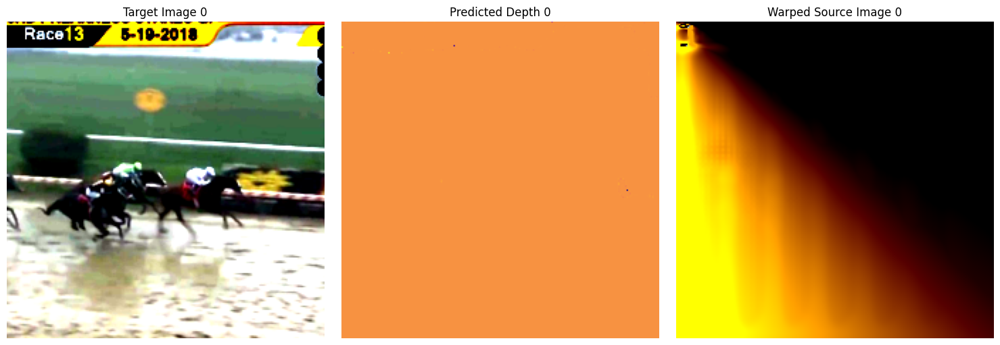

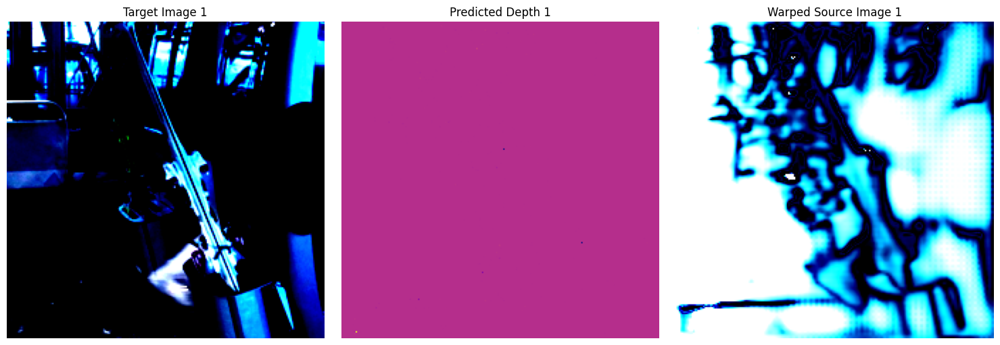

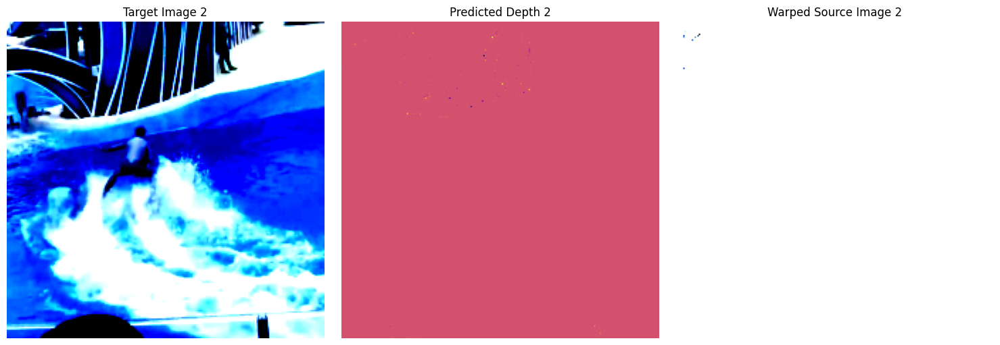

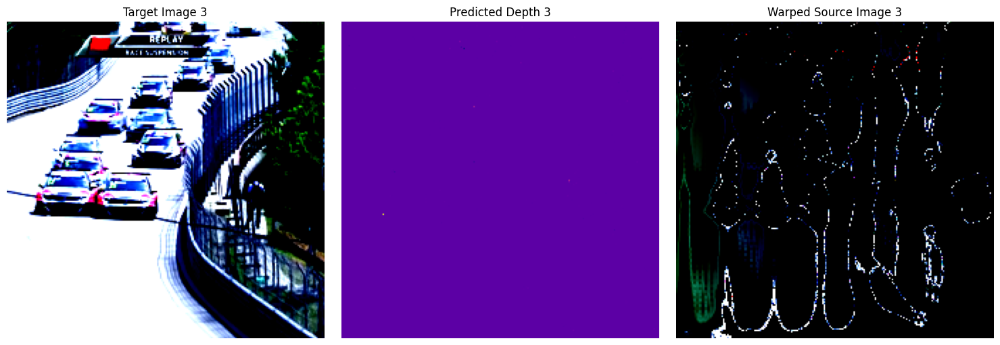

In [ ]:
val_results(depth_B, pose_B)

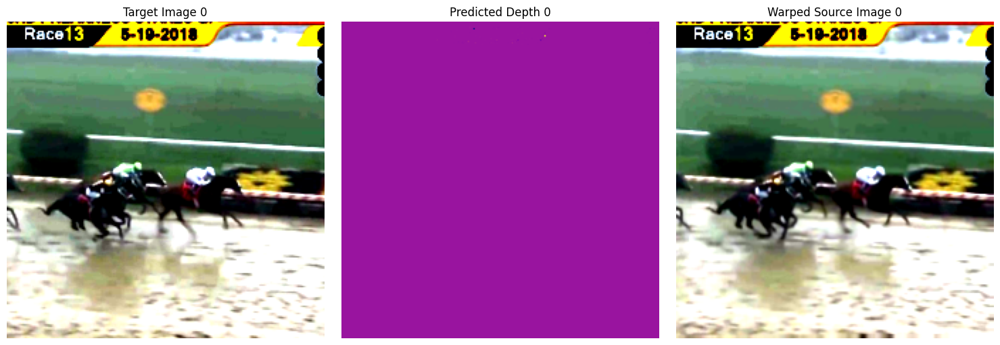

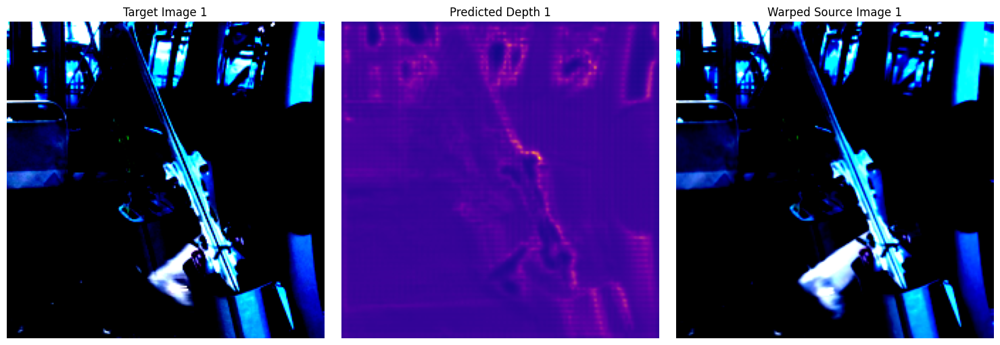

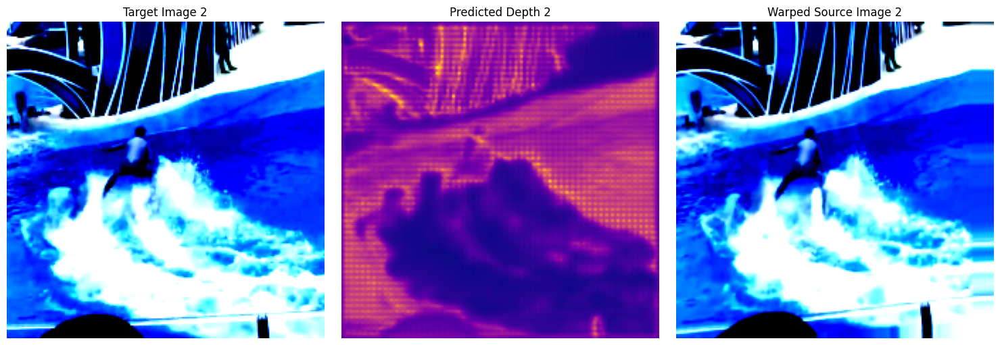

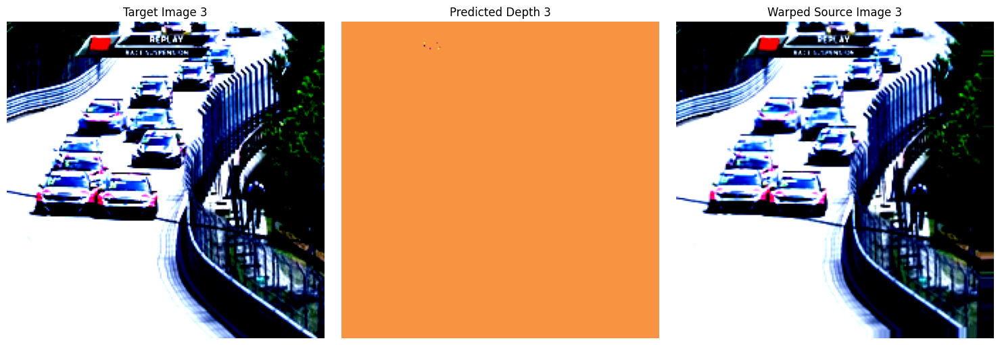

In [ ]:
val_results(depth_Ba, pose_Ba)

### Version C

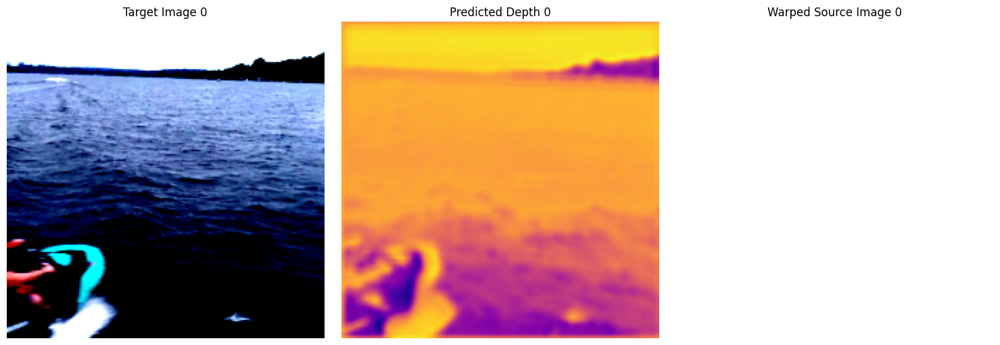

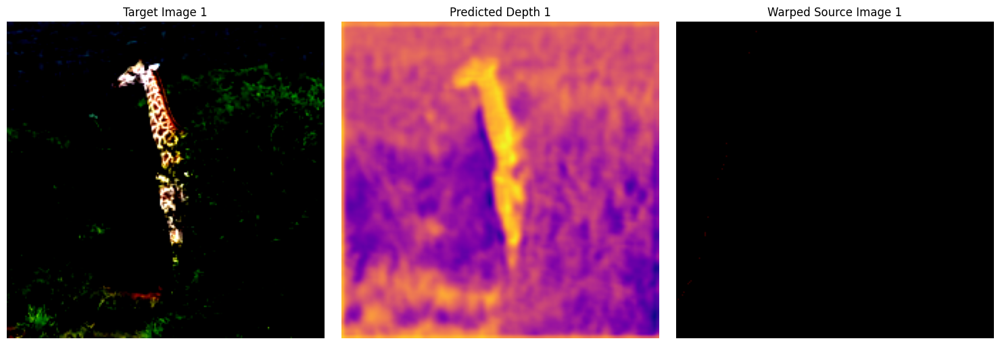

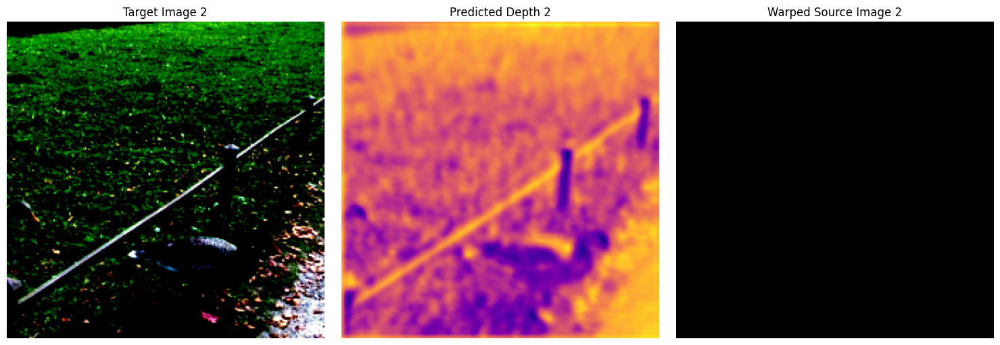

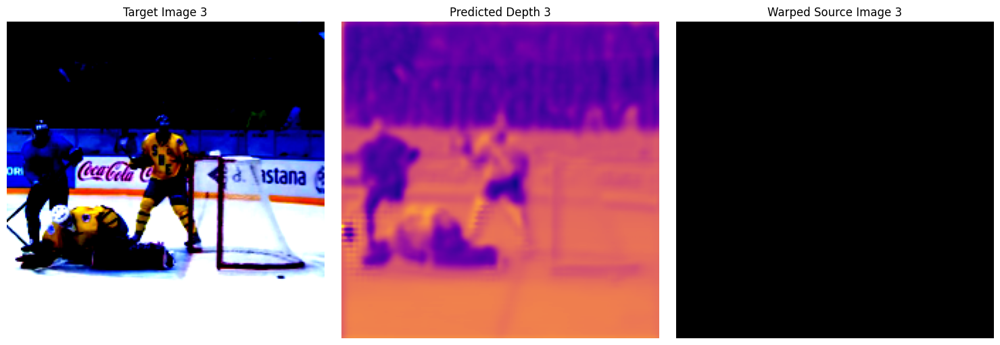

In [ ]:
val_results(depth_C, pose_C)

### Version D

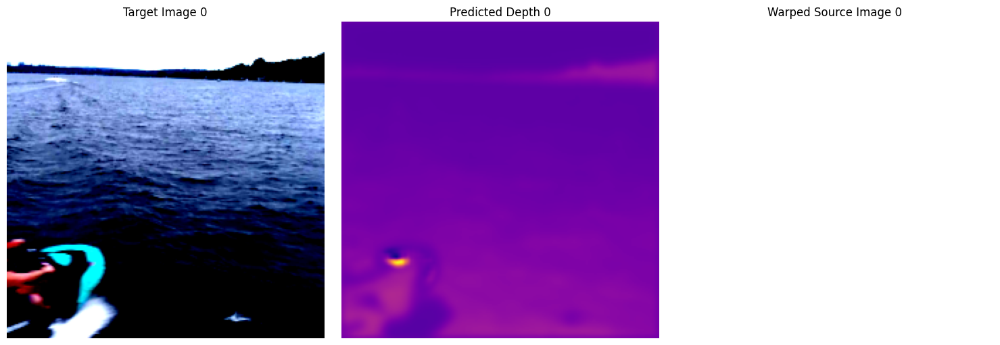

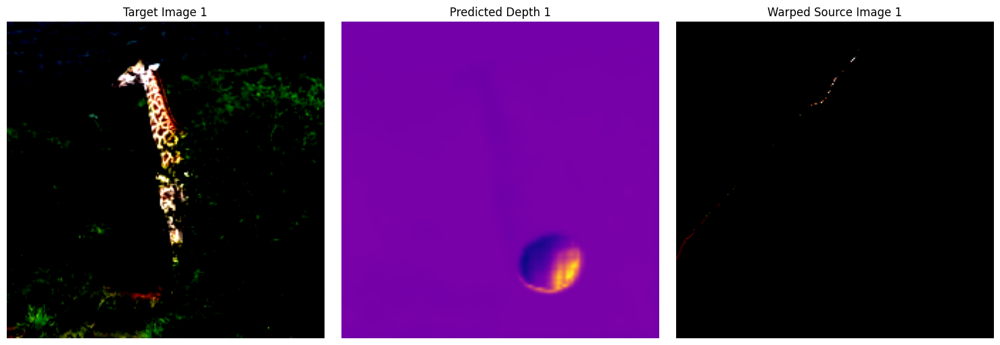

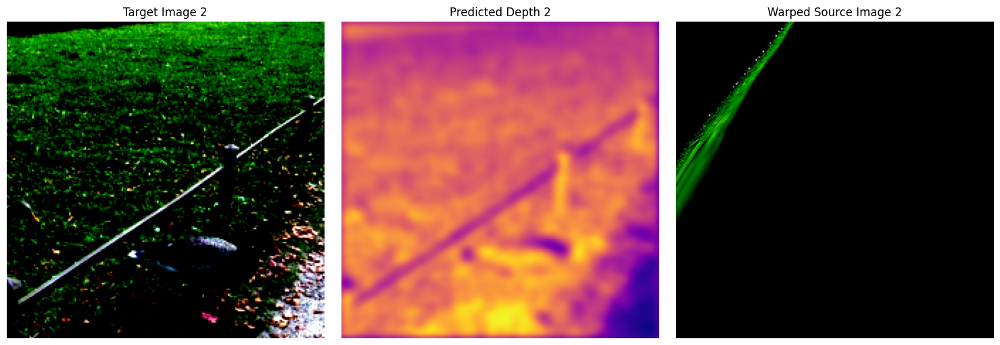

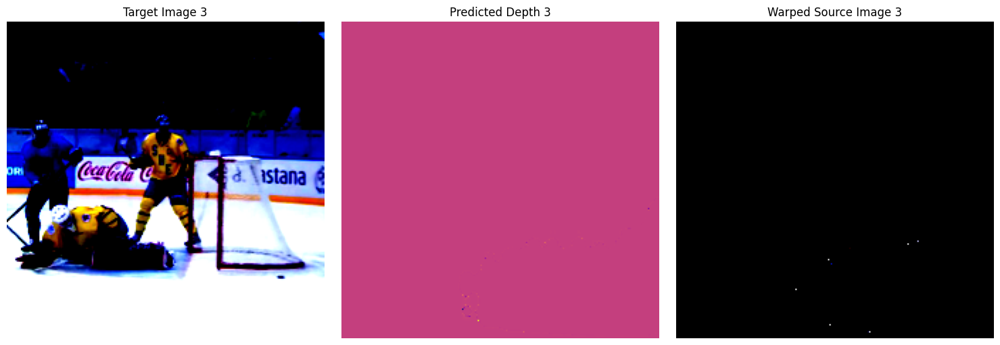

In [ ]:
val_results(depth_D, pose_D)

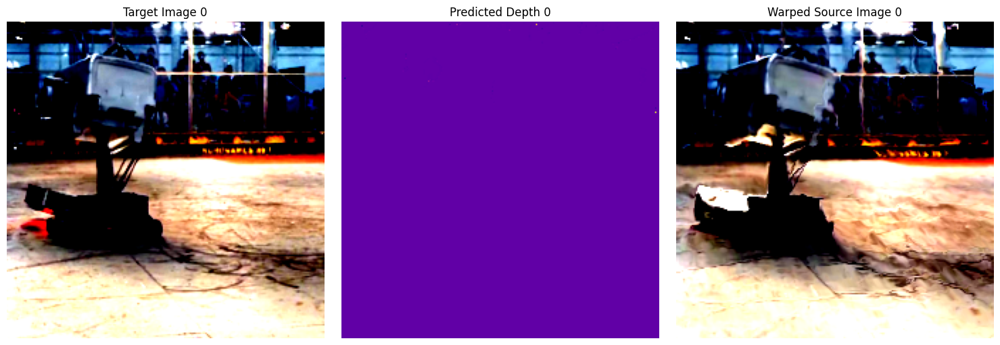

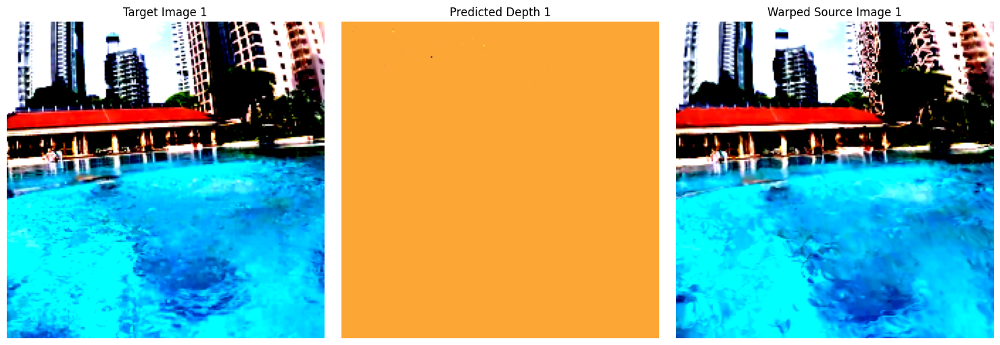

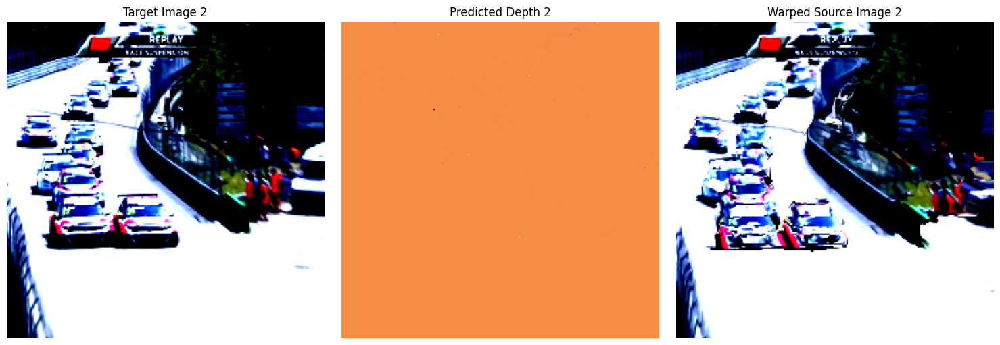

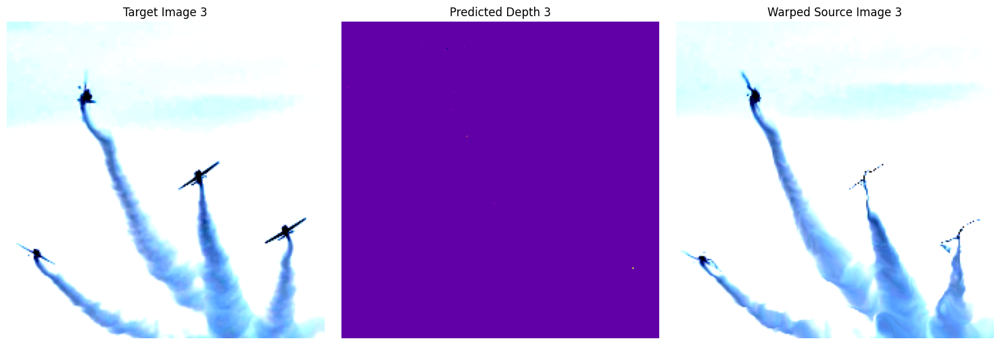

In [ ]:
val_results(depth_D, pose_D)

### Version E

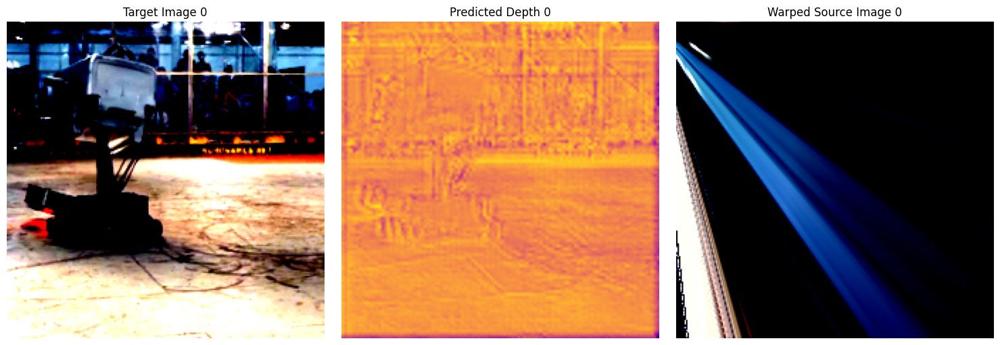

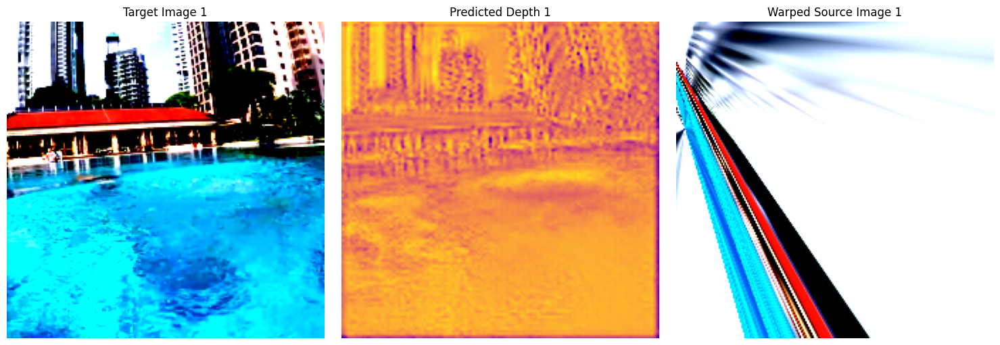

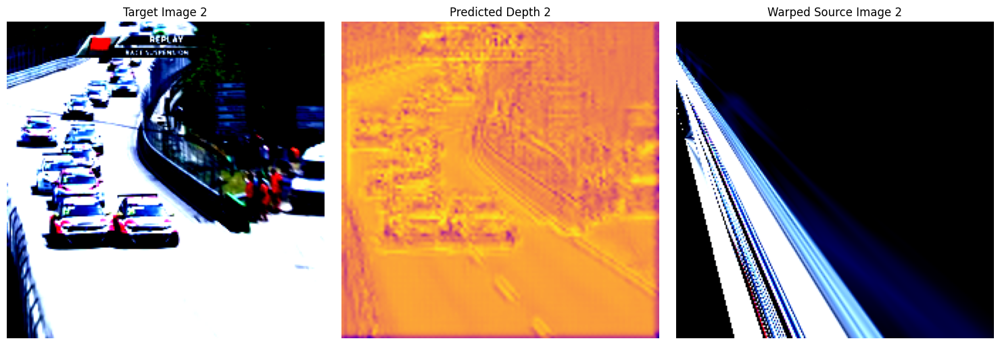

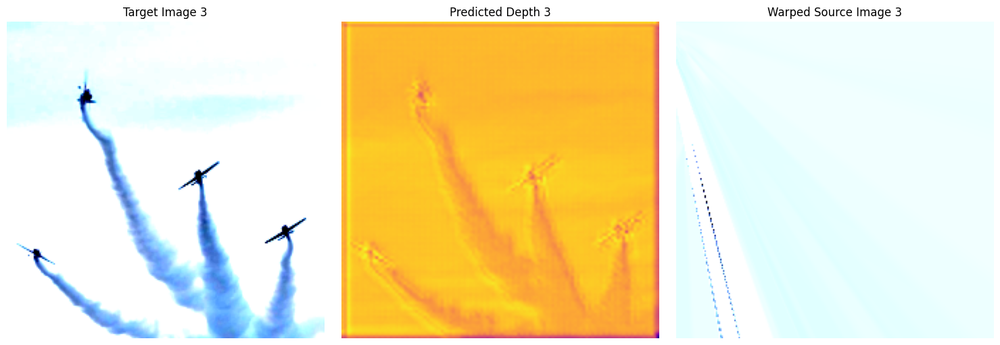

In [ ]:
val_results(depth_E, pose_E)

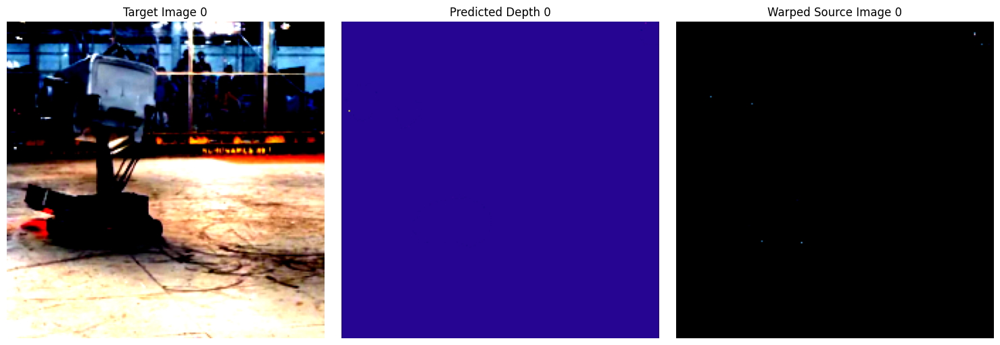

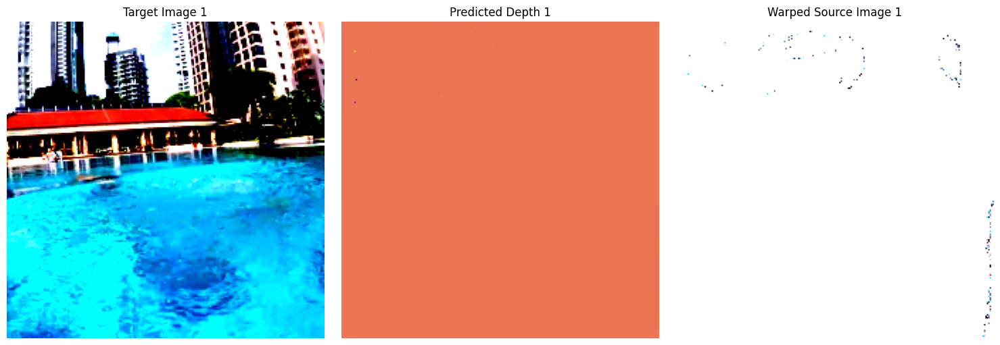

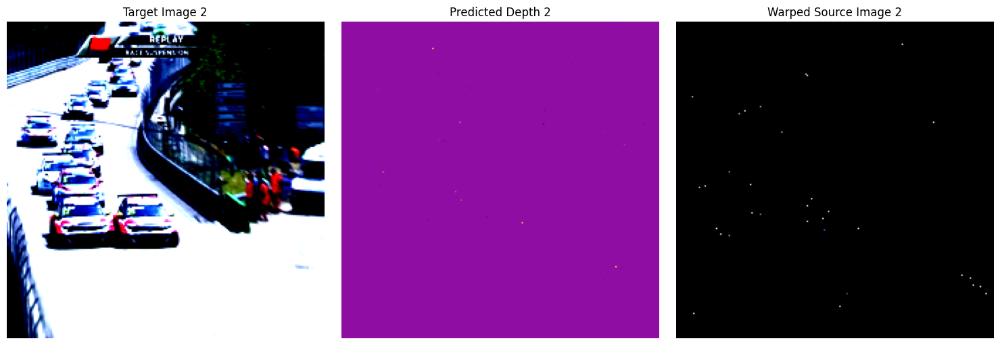

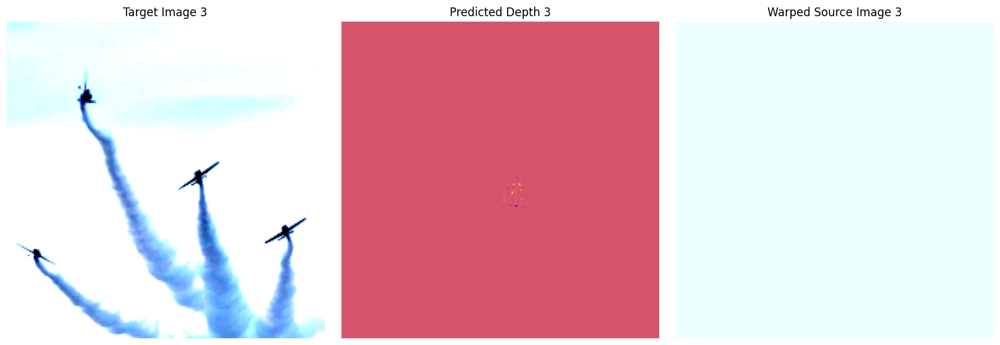

In [ ]:
val_results(depth_E, pose_E)

### Version Ca

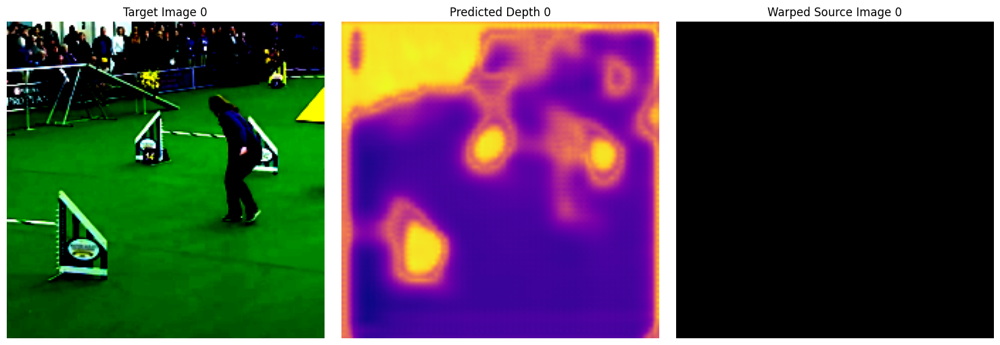

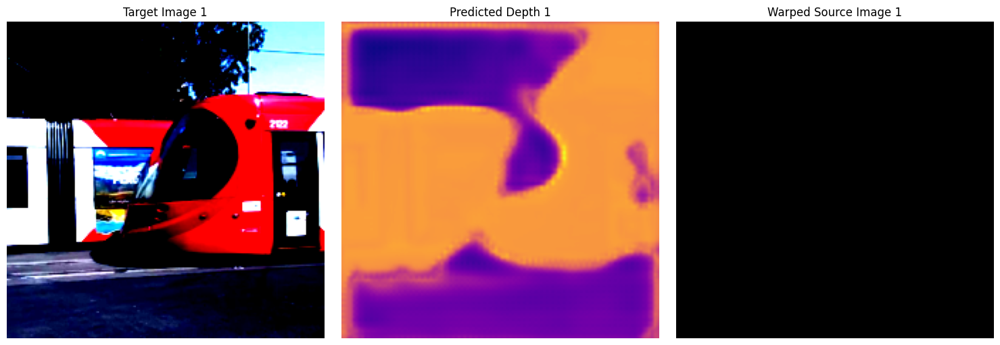

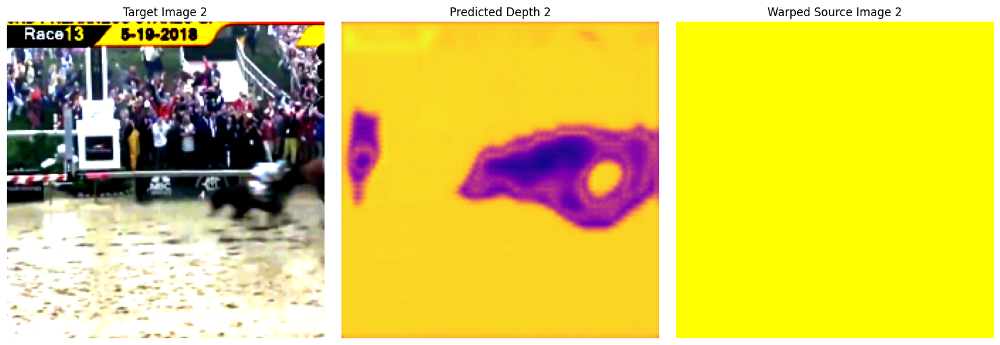

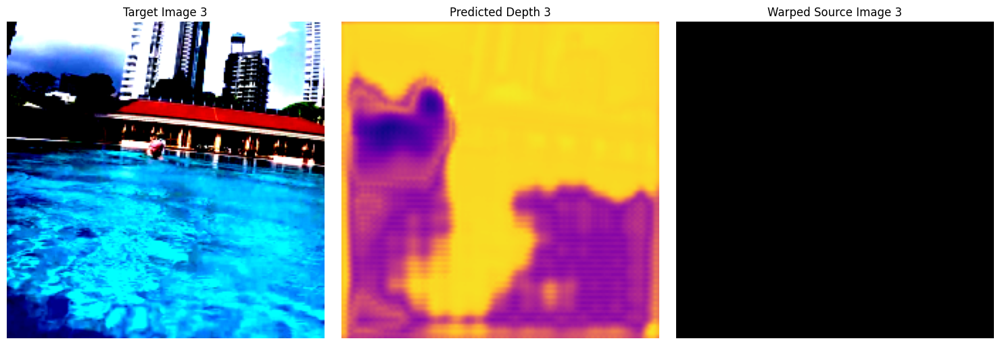

In [ ]:
val_results(depth_Ca, pose_Ca)

### Version Baa

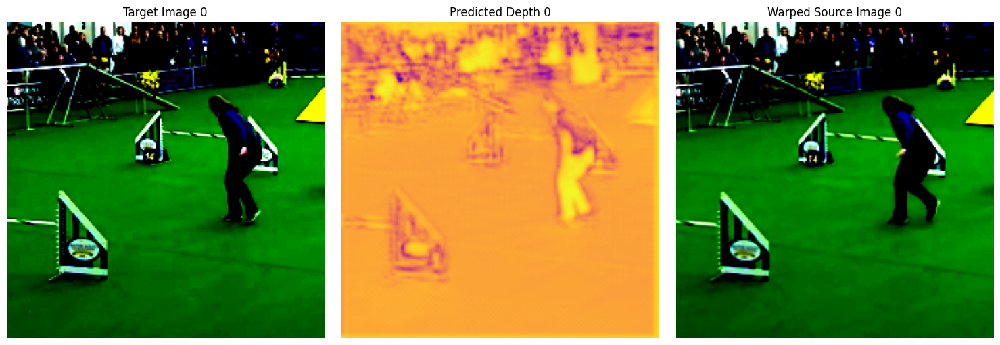

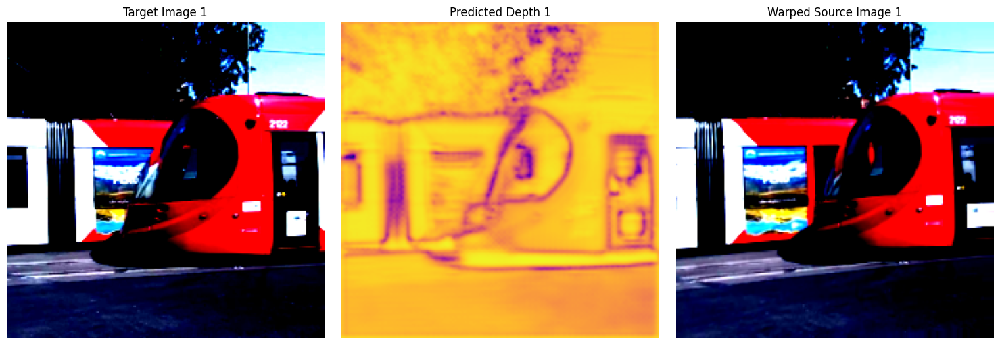

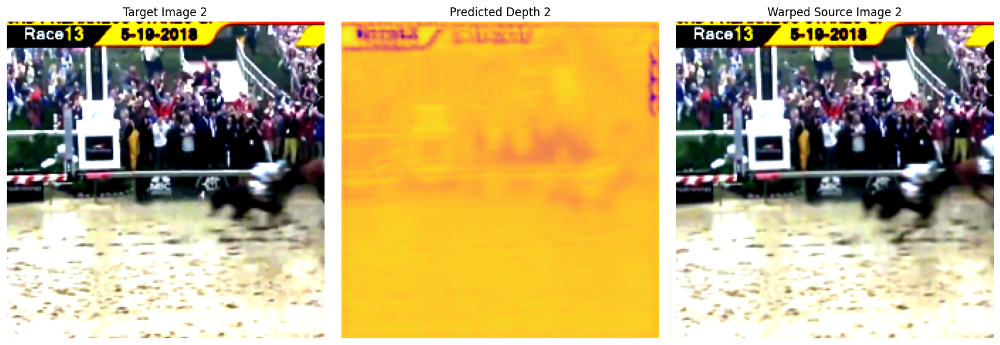

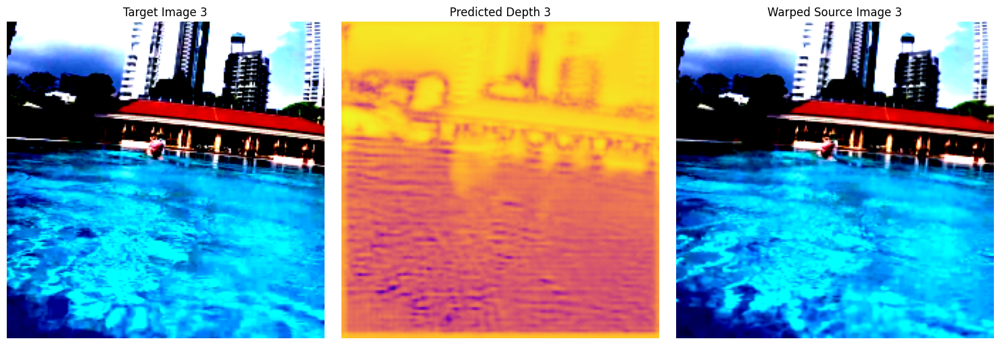

In [ ]:
val_results(depth_Baa, pose_Baa)

### Version CaBaa

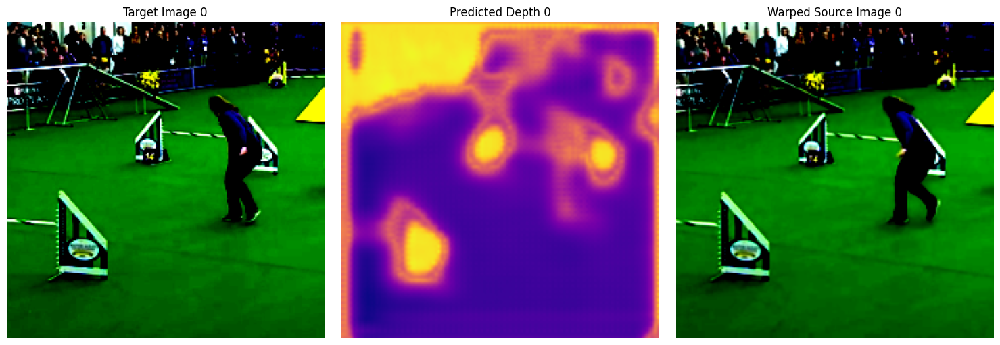

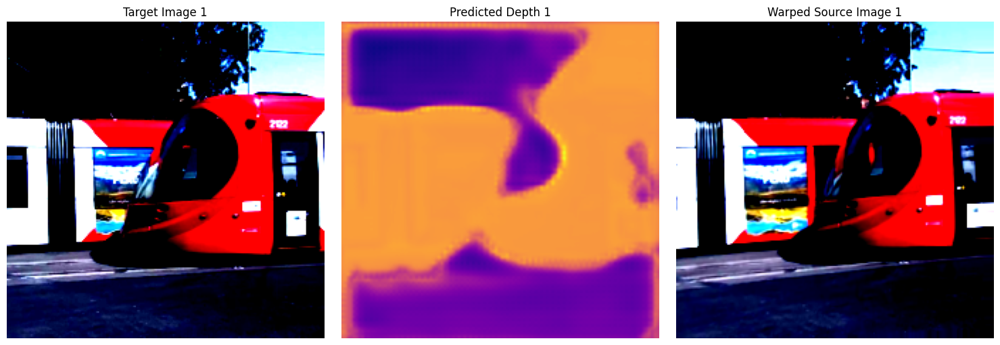

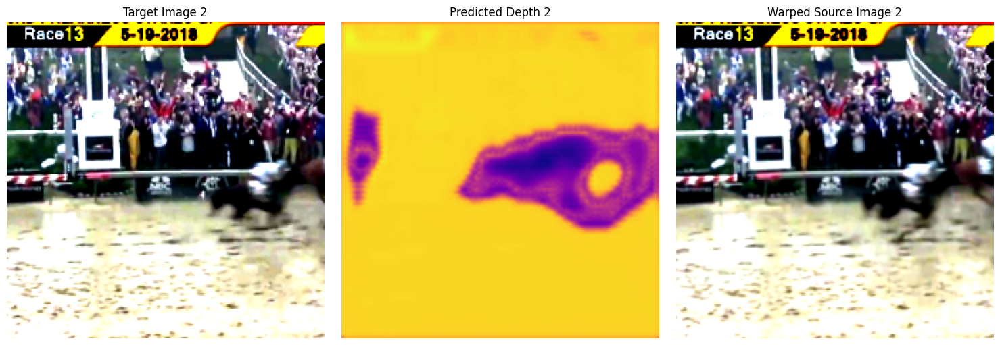

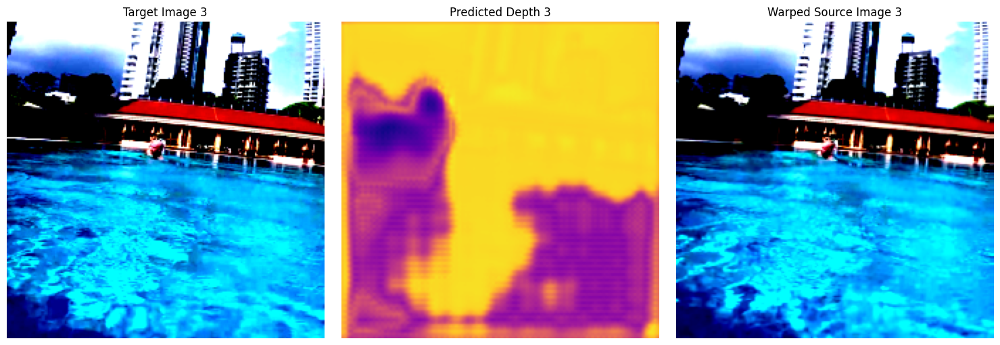

In [ ]:
val_results(depth_Ca, pose_Baa)

# **DOWNLOAD**

In [ ]:
from google.colab import files

In [ ]:
torch.save(depth_Ca.state_dict(), "depth_Ca_weights.pth")
files.download("depth_Ca_weights.pth")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
torch.save(pose_Baa.state_dict(), "pose_Ba_weights100.pth")
files.download("pose_Ba_weights100.pth")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>